<a href="https://colab.research.google.com/github/anjalipatel101/481_Project_Fall_2023/blob/bird_yn/bird_yn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

INITIAL SET UP (ALL BASES COVERED)


In [ ]:
import keras
from keras import backend as K
from keras.layers.core import Dense, Activation
from keras.optimizers import Adam
from keras.metrics import categorical_crossentropy
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing import image
from keras.models import Model
from keras.applications import imagenet_utils
import numpy as np
from IPython.display import Image

ModuleNotFoundError: ignored

In [ ]:
!pip install opendatasets
!pip install pandas

In [ ]:
import opendatasets as od
import pandas

od.download(
    "https://www.kaggle.com/datasets/rafsunahmad/choose-your-pet/"
)



Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: a_pat101
Your Kaggle Key: ··········


KeyError: ignored

START HERE:
Run each time and look through single and multi image display

In [1]:
from google.colab import drive

#used for unmounting the drive
drive.flush_and_unmount()

drive.mount('/content/drive')

#Unzip archive.zip for access to animal images
!unzip '/content/drive/MyDrive/archive4.zip'


Streaming output truncated to the last 5000 lines.
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/4.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/40.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/41.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/42.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/43.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/44.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/45.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/46.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/47.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/48.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/49.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/5.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/50.jpg  
  inflating: Cats-and-Dogs-Breed-Dataset-main/TRAIN/bengal/51.jpg  

In [2]:
!pip install Pillow

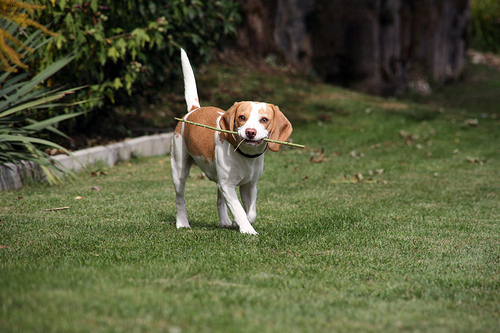

In [17]:
#DISPLAYING SINGLE IMAGES TEST
import os
from IPython.display import display, Image
from PIL import Image as PILImage

# Set the path to your dataset in Google Drive
dataset_path = '/content/Cats-and-Dogs-Breed-Dataset-main/TRAIN/beagle'

# List files in the dataset directory
file_list = os.listdir(dataset_path)
first_image_path = os.path.join(dataset_path, file_list[10])
img = PILImage.open(first_image_path)
display(img)


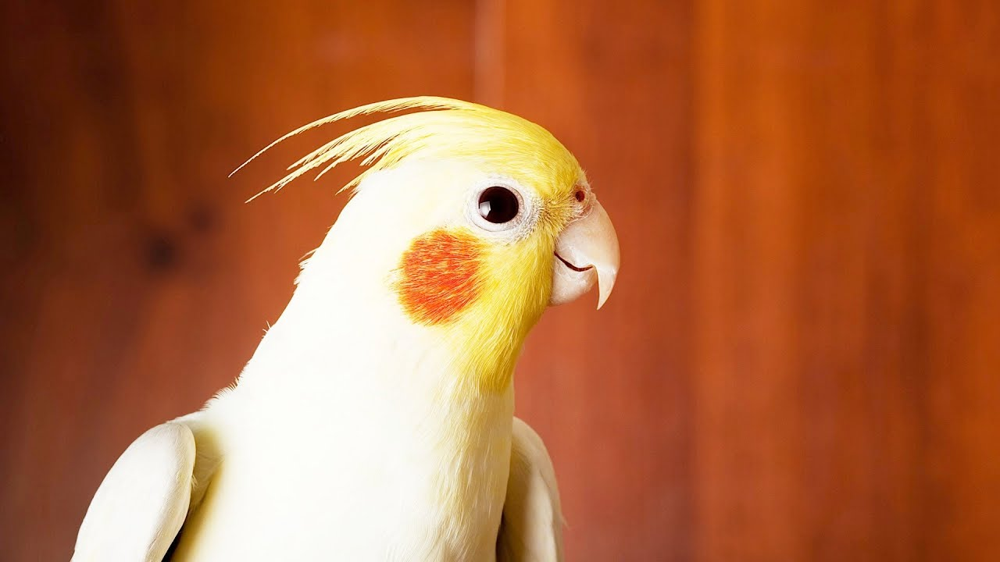

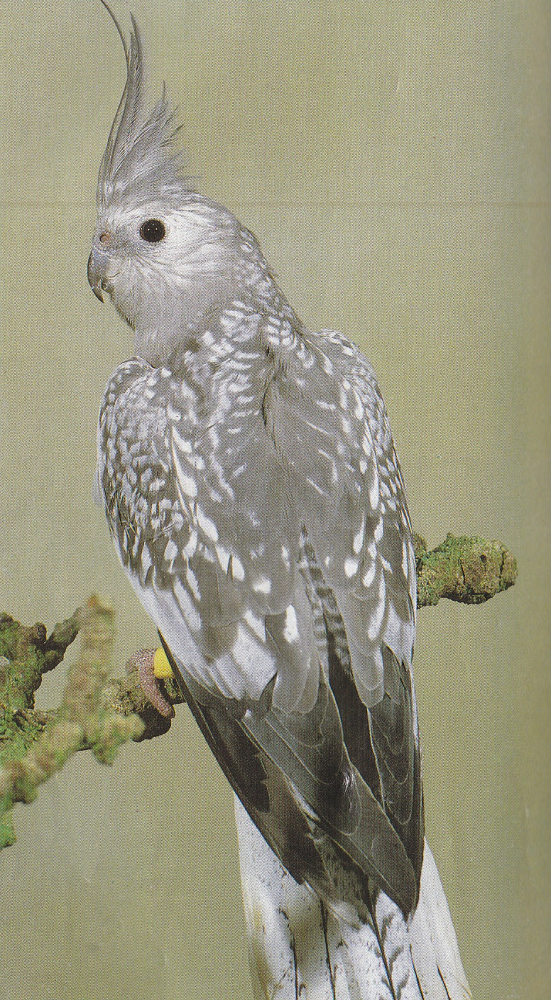

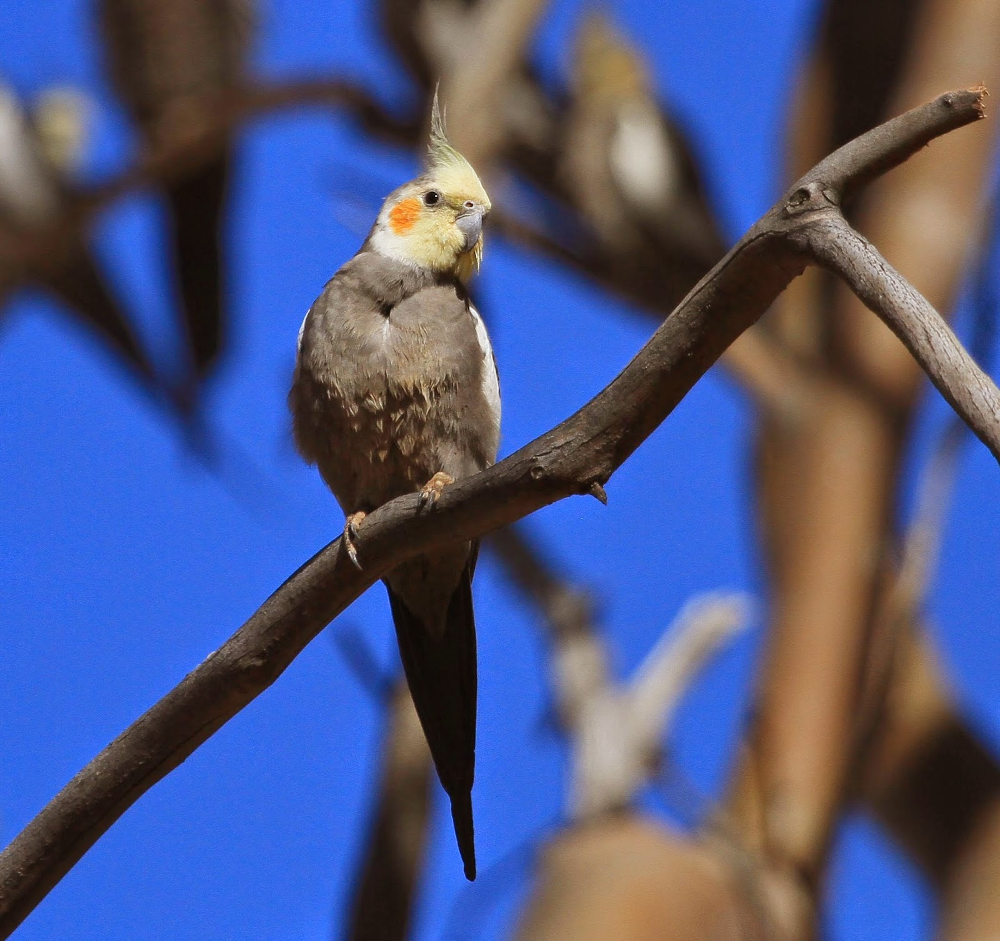

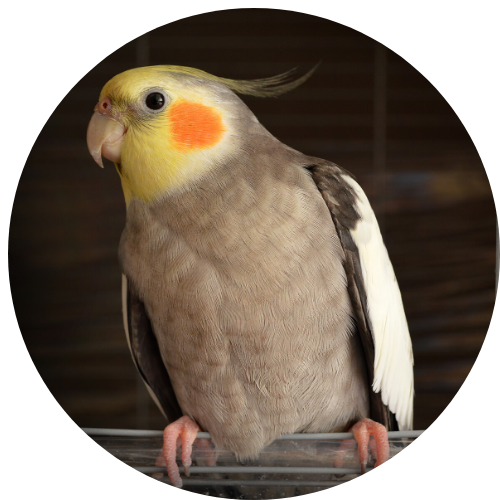

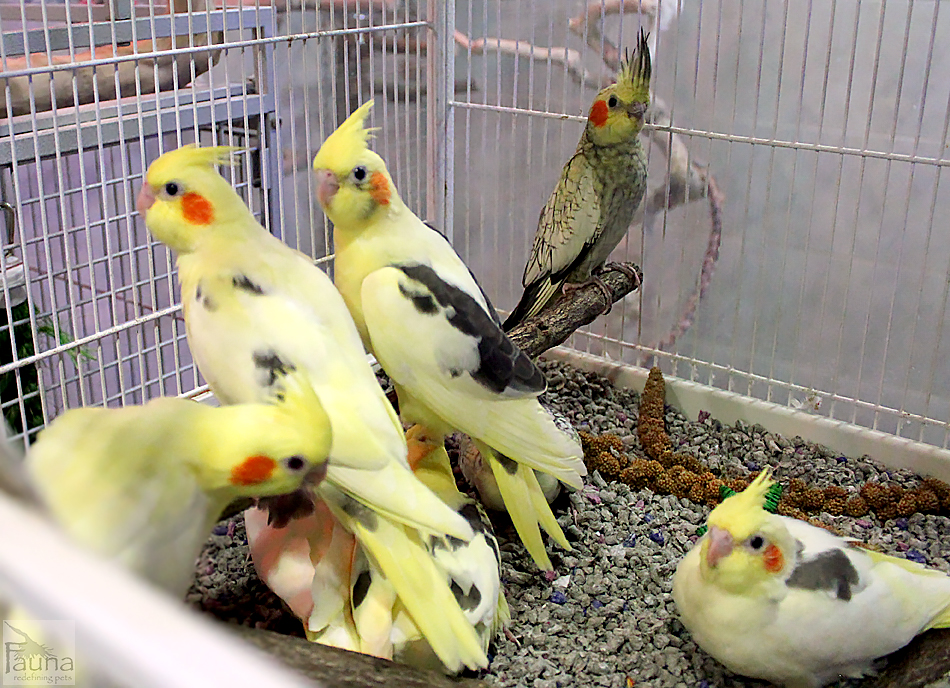

...

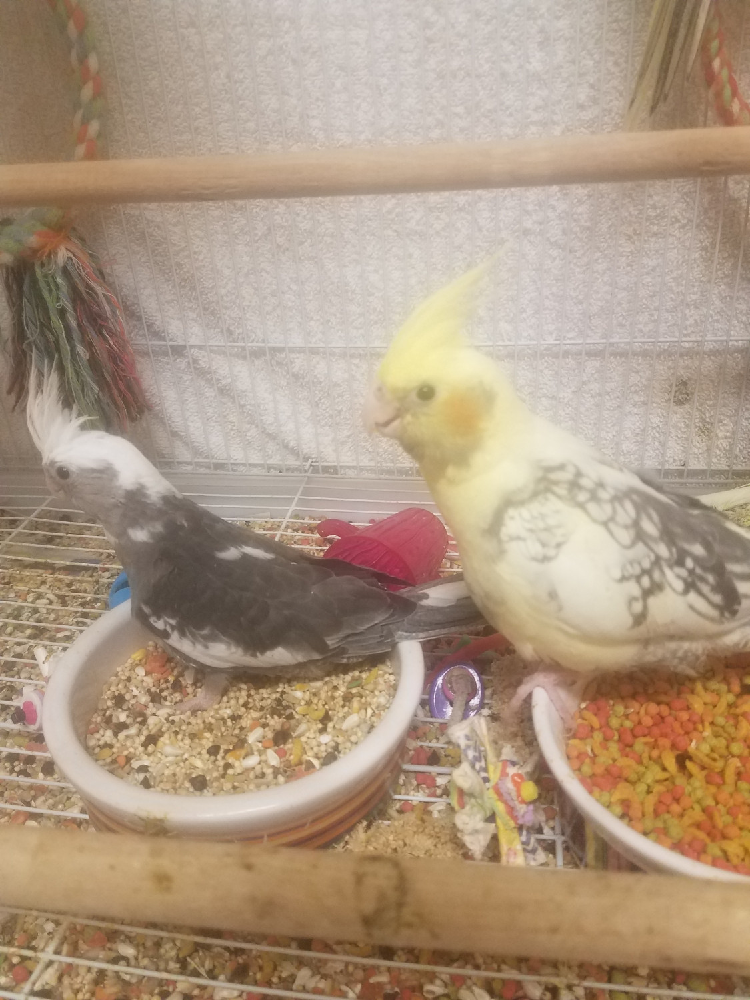

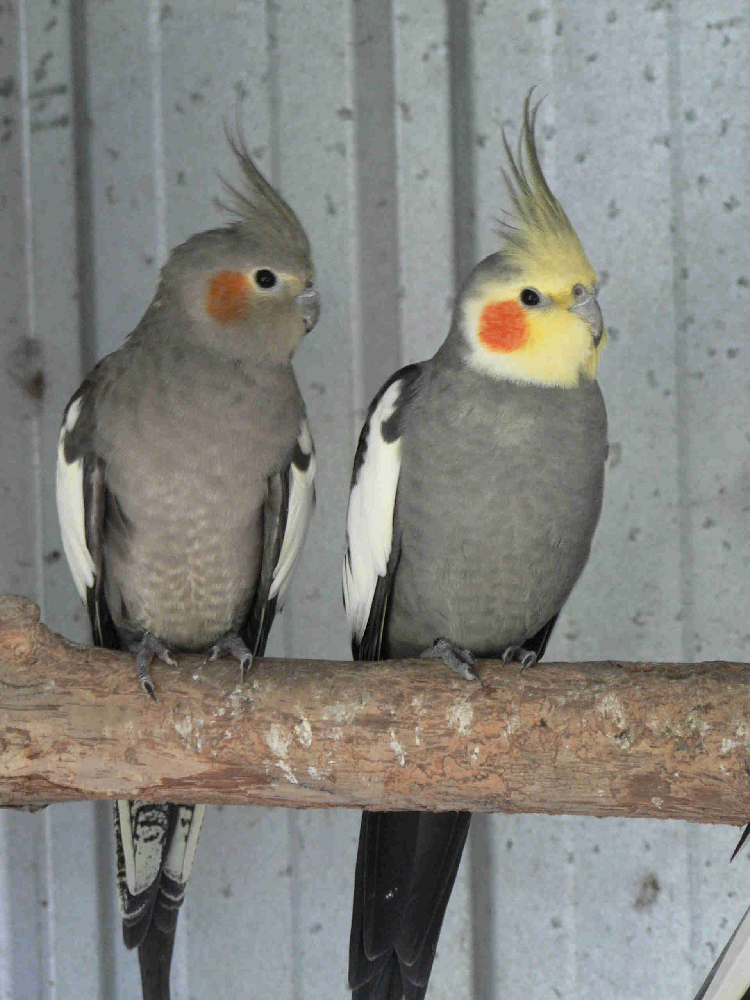

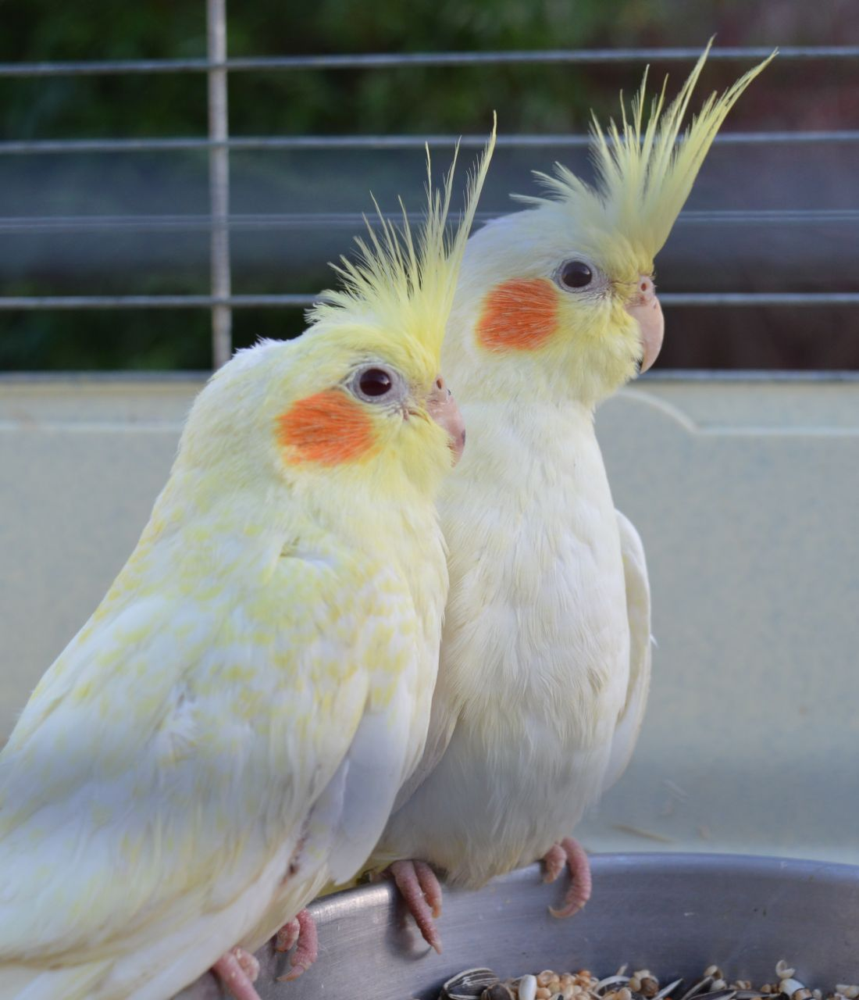

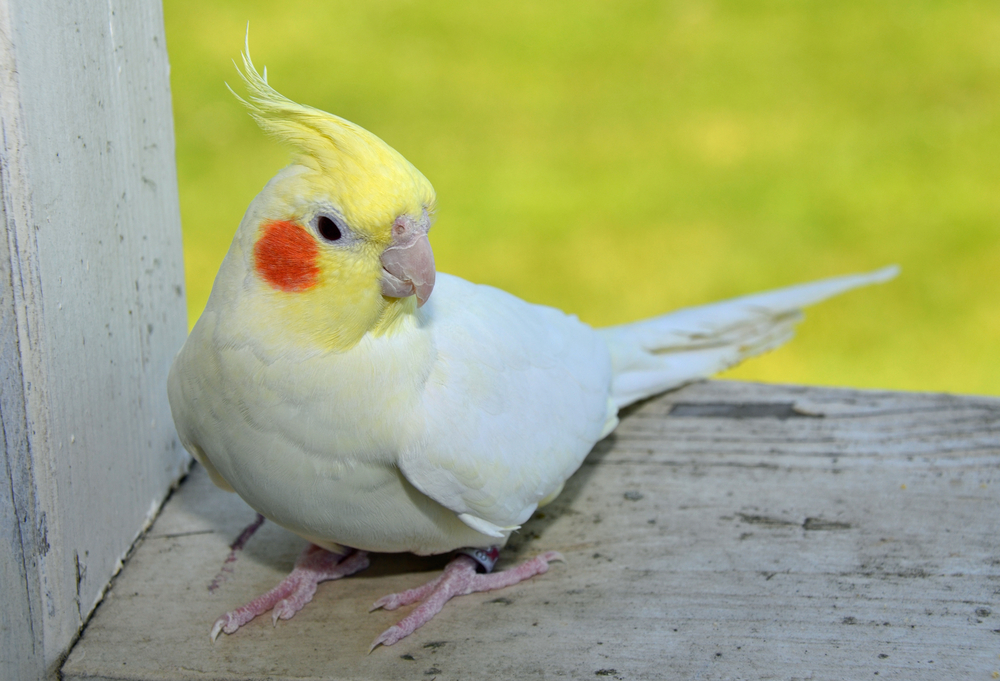

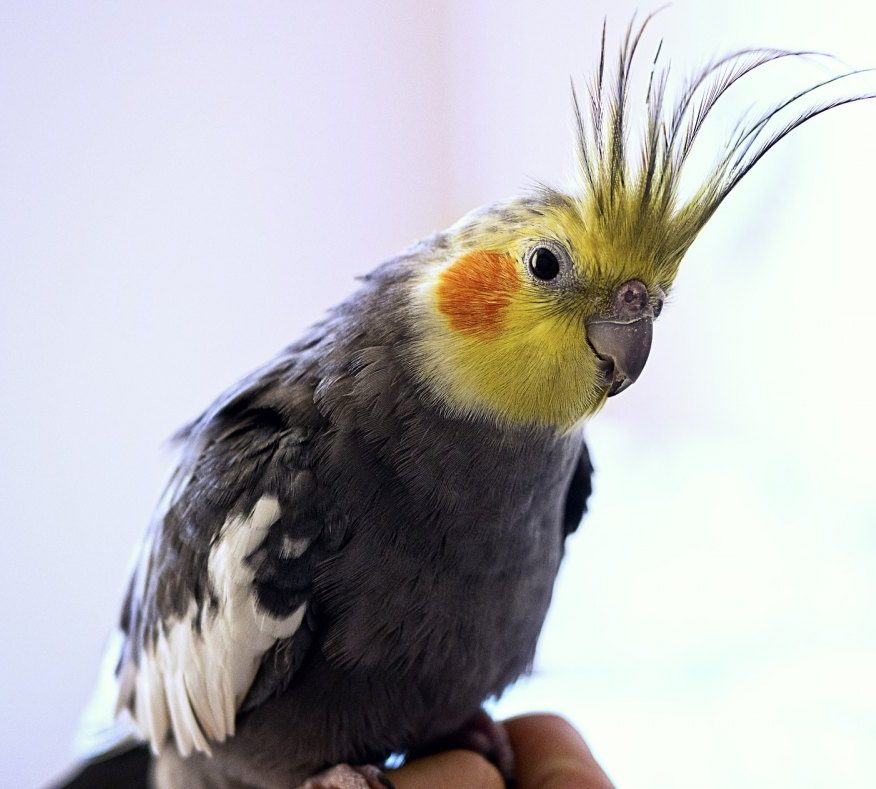

In [ ]:
#### DISPLAYING IMAGES TEST ####
from IPython.display import display, Image
from PIL import Image as PILImage
import os

# Set the path to your dataset in Google Drive
dataset_path = '/content/Choose pet datset for kaggle/Cockatiel'

# List files in the dataset directory
file_list = os.listdir(dataset_path)

# Iterate through all images and display each one
for filename in file_list:
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Filter only image files
        image_path = os.path.join(dataset_path, filename)
        img = PILImage.open(image_path)
        display(img)




NEED TO FIX


** Goal: train the data on the images to get it to output y/n if a picture is a bird or not

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [ ]:
batch_size = 32
img_height = 180
img_width = 180

In [ ]:
data_dir = '/content/Choose pet datset for kaggle'

In [ ]:
#This determines what images within the dataset will be used for training the model

train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 2262 files belonging to 74 classes.
Using 1810 files for training.


In [ ]:
#This determines what images within the dataset will be used for validating the model


val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 2262 files belonging to 74 classes.
Using 452 files for validation.


In [ ]:
#Testing Purposes:
class_names = train_ds.class_names
print('Training: ', class_names)

#Realized this was not going to work as images for training and testing were taken from all folders within the datsset
#Thus, when outputting class names, it showed that the images for each respective set were from ALL the folders

Training:  ['Abyssinian', 'African Dwarf Frog', 'African Grey Parrot', 'American Shorthair', 'American Toad', 'Axolotls', 'Beagle', 'Bearded Dragon', 'Bengal', "Bourke's Parakeet", 'Boxer', 'British Shorthair', 'Budgerigar', 'Bulldog', 'Burmese', 'Canary', 'Chameleon', 'Chinchillas', 'Cockatiel', 'Cockatoo', 'Cocker Spaniel', 'Crested Gecko', 'Dachshund', 'Degus', 'Devon Rex', 'Eastern Newt', 'Egyptian Mau', 'Ferrets', 'Finch', 'Fox', 'French Bulldog', 'Frogs with Tadpoles', 'Gerbils', 'German Shepherd', 'Golden Retriever', 'Great Dane', 'Green Iguana', 'Guinea Pigs', 'Hamsters', 'Hedgehogs', 'Himalayan', 'Horned Toads', 'Horses', 'Hyacinth Macaws', 'Labrador Retriever', 'Leopard Gecko', 'Lovebird', 'Maine Coon', 'Mice', 'Miniature Schnauzer', 'Monitor Lizards', 'Parrotlet', 'Persian', 'Pionus Parrot', 'Poison Dart Frogs', 'Poodle', 'Prairie Dogs', 'Quaker Parrot', 'Rabbits', 'Ragdoll', 'Rats', 'Red-eyed Tree Frog', 'Rottweiler', 'Russian Blue', 'Salamander', 'Scottish Fold', 'Serval C

In [ ]:


## VISUALIZE DATA FIRST 9 ##
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")




NameError: ignored

<Figure size 1000x1000 with 0 Axes>

In [ ]:
import os
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2, preprocess_input, decode_predictions

# Load the pre-trained MobileNetV2 model
model = MobileNetV2(weights='imagenet')

def predict_bird(image_path):
    # Load and preprocess the input image
    img = image.load_img(image_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = img_array / 255.0  # Normalize pixel values to be between 0 and 1
    img_array = preprocess_input(np.expand_dims(img_array, axis=0))

    # Make predictions
    predictions = model.predict(img_array)
    decoded_predictions = decode_predictions(predictions, top=1)[0]

    # Check if the top prediction is a bird
    return "bird" in decoded_predictions[0][1].lower()

def identify_birds_in_dataset(dataset_dir):
    # Iterate through each file in the directory
    for filename in os.listdir(dataset_dir):
        if filename.endswith(".jpg") or filename.endswith(".png"):
            # Construct the full path to the image
            image_path = os.path.join(dataset_dir, filename)

            # Use the predict_bird function to determine if the image contains a bird
            is_bird = predict_bird(image_path)

            # Print the result
            if is_bird:
                print(f"{filename}: The animal in the image is a bird.")
            else:
                print(f"{filename}: The animal in the image is not a bird.")

# Directory containing the animal dataset
animal_dataset_dir = '/content/Choose pet datset for kaggle/Canary'

# Identify birds in the dataset
identify_birds_in_dataset(animal_dataset_dir)


In [ ]:
#mobile = keras.applications.mobilenet.MobileNet()

#def img_prep(file):
 # img_path = ' '
  #img = image.load_img(img_path + file, target_size=(224,224))
  #biarray = image.img_to_array(img)
  #biarray_large = np.expand_dims(img_array, axis = 0)
  #return keras.applications.mobilenet.preprocess_input(biarray_large)

## Save the entire model

Call `tf.keras.Model.save` to save a model's architecture, weights, and training configuration in a single `model.keras` zip archive.

An entire model can be saved in three different file formats (the new `.keras` format and two legacy formats: `SavedModel`, and `HDF5`). Saving a model as `path/to/model.keras` automatically saves in the latest format.

**Note:** For Keras objects it's recommended to use the new high-level `.keras` format for richer, name-based saving and reloading, which is easier to debug. The low-level SavedModel format and legacy H5 format continue to be supported for existing code.

You can switch to the SavedModel format by:

- Passing `save_format='tf'` to `save()`
- Passing a filename without an extension

You can switch to the H5 format by:
- Passing `save_format='h5'` to `save()`
- Passing a filename that ends in `.h5`

Saving a fully-functional model is very useful—you can load them in TensorFlow.js ([Saved Model](https://www.tensorflow.org/js/tutorials/conversion/import_saved_model), [HDF5](https://www.tensorflow.org/js/tutorials/conversion/import_keras)) and then train and run them in web browsers, or convert them to run on mobile devices using TensorFlow Lite ([Saved Model](https://www.tensorflow.org/lite/models/convert/#convert_a_savedmodel_recommended_), [HDF5](https://www.tensorflow.org/lite/models/convert/#convert_a_keras_model_))

\*Custom objects (for example, subclassed models or layers) require special attention when saving and loading. Refer to the **Saving custom objects** section below.